In [1]:
import matplotlib.pyplot as plt
import matplotlib.image as img
import numpy as np

%matplotlib inline

import os
from os import listdir
from os.path import isfile, join
from keras.utils.np_utils import to_categorical
from keras.applications.inception_v3 import preprocess_input
from keras.preprocessing import image

Using TensorFlow backend.


In [7]:
root_dir = 'food-101/images/'
sorted_food_dirs = sorted(os.listdir(root_dir))
sorted_food_dirs=sorted_food_dirs[1:]
sorted_food_dirs
name=[]
picture=[]
for i in sorted_food_dirs:
    food_dir = i
    all_files = os.listdir(os.path.join(root_dir, food_dir))
    j=0
    while j<6:
        rand_img = np.random.choice(all_files)
        path=os.path.join(root_dir, food_dir, rand_img)
        img = image.load_img(path)
        x=image.img_to_array(img)
        if x.shape[0]==512:
            if x.shape[1]==512:
                picture.append(x) 
                name.append(food_dir)
                j=j+1
len(picture)

606

In [8]:
import pandas as pd
Food_matrix=pd.DataFrame({"name":name,"picture":picture})

In [9]:
Food_matrix.tail()

,name,picture
601,waffles,"[[[125.0, 106.0, 128.0], [115.0, 96.0, 116.0],..."
602,waffles,"[[[168.0, 197.0, 192.0], [195.0, 224.0, 219.0]..."
603,waffles,"[[[106.0, 97.0, 90.0], [111.0, 102.0, 95.0], [..."
604,waffles,"[[[14.0, 15.0, 33.0], [14.0, 15.0, 33.0], [14...."
605,waffles,"[[[41.0, 38.0, 29.0], [40.0, 37.0, 28.0], [38...."


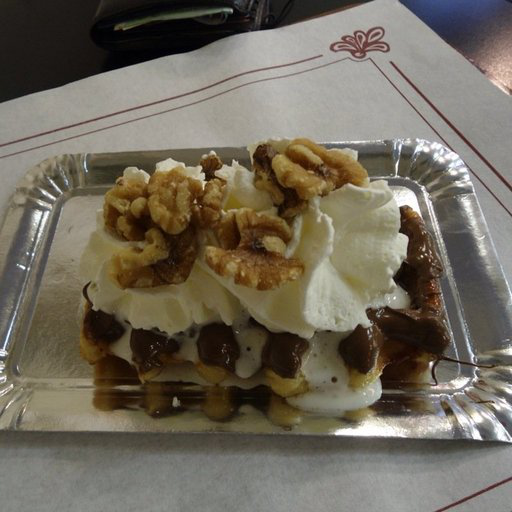

In [10]:
img

In [11]:
X=Food_matrix.picture
y=Food_matrix.name
X[0].shape

(512, 512, 3)

In [12]:
from sklearn.preprocessing import LabelEncoder
label_encoder=LabelEncoder()
label_encoder.fit(y)
encoded_y=label_encoder.transform(y)

In [13]:
X[100].shape

(512, 512, 3)

In [14]:
type(X)

pandas.core.series.Series

In [15]:
for i in range(0,len(X)):
    ndims=X[i].shape[1]*X[i].shape[2]
    X[i]=X[i].reshape(X[i].shape[0],ndims).reshape(-1,1)   
X

0      [[238.0], [249.0], [241.0], [236.0], [247.0], ...
1      [[121.0], [53.0], [64.0], [122.0], [54.0], [67...
2      [[246.0], [242.0], [213.0], [245.0], [241.0], ...
3      [[91.0], [118.0], [101.0], [89.0], [116.0], [9...
4      [[196.0], [234.0], [255.0], [191.0], [229.0], ...
5      [[57.0], [63.0], [75.0], [49.0], [56.0], [66.0...
6      [[172.0], [137.0], [117.0], [168.0], [136.0], ...
7      [[12.0], [9.0], [2.0], [13.0], [10.0], [3.0], ...
8      [[141.0], [86.0], [47.0], [136.0], [80.0], [43...
9      [[39.0], [12.0], [3.0], [44.0], [15.0], [7.0],...
10     [[32.0], [25.0], [0.0], [46.0], [39.0], [11.0]...
11     [[29.0], [0.0], [28.0], [29.0], [0.0], [28.0],...
12     [[228.0], [197.0], [153.0], [226.0], [195.0], ...
13     [[53.0], [43.0], [18.0], [55.0], [45.0], [20.0...
14     [[60.0], [56.0], [53.0], [62.0], [58.0], [55.0...
15     [[141.0], [112.0], [20.0], [157.0], [127.0], [...
16     [[127.0], [109.0], [63.0], [127.0], [109.0], [...
17     [[17.0], [17.0], [17.0],

In [16]:
for i in range(0,len(X)):
    ndims=X[i].shape[0]*X[i].shape[1]
    X[i]=X[i].reshape(ndims)

In [17]:
X.shape

(606,)

In [18]:
X=preprocess_input(X)

In [19]:
X_list=[]
for i in range(0,len(X)):
    X_list.append(X[i].tolist())    
len(X_list)

606

In [20]:
X_list

[[0.8666666746139526,
  0.9529411792755127,
  0.8901960849761963,
  0.8509804010391235,
  0.9372549057006836,
  0.8745098114013672,
  0.8666666746139526,
  0.9450980424880981,
  0.8823529481887817,
  0.8980392217636108,
  0.9764705896377563,
  0.9137254953384399,
  0.9137254953384399,
  0.9921568632125854,
  0.929411768913269,
  0.9058823585510254,
  0.9843137264251709,
  0.9215686321258545,
  0.8901960849761963,
  0.9686274528503418,
  0.9058823585510254,
  0.9058823585510254,
  0.9607843160629272,
  0.9058823585510254,
  0.8666666746139526,
  0.9215686321258545,
  0.8666666746139526,
  0.9137254953384399,
  0.9686274528503418,
  0.9137254953384399,
  0.9450980424880981,
  0.9843137264251709,
  0.929411768913269,
  0.9058823585510254,
  0.9450980424880981,
  0.8901960849761963,
  0.8666666746139526,
  0.9058823585510254,
  0.8509804010391235,
  0.8823529481887817,
  0.9215686321258545,
  0.8666666746139526,
  0.9137254953384399,
  0.9529411792755127,
  0.8980392217636108,
  0.92941176

In [21]:
scores=[]
from sklearn.neighbors import KNeighborsClassifier
for k in range(3,10,2):
    knn=KNeighborsClassifier(n_neighbors=k)
    knn.fit(X_list,encoded_y)
    score=knn.score(X_list,encoded_y)
    scores.append(score)
    print(f"k:{k}, score:{score}")

k:3, score:0.23597359735973597
k:5, score:0.16501650165016502
k:7, score:0.14026402640264027
k:9, score:0.12211221122112212


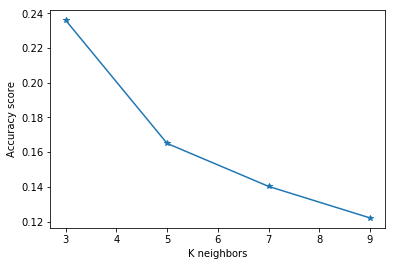

In [30]:
K=list(range(3,10,2))
plt.plot(K,scores,marker="*")
plt.xlabel("K neighbors")
plt.ylabel("Accuracy score")
plt.show()